# Instalando dependências

In [1]:
%pip install numpy
%pip install matplotlib
%pip install scipy
%pip install soundfile
%pip install Ipython

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


# Importando bibliotecas

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
import soundfile as sf
import IPython.display as ipd

# Carregando a resposta ao impulso


In [3]:
resp_imp_3 = np.genfromtxt('Arquivos/Medições/SEC_3.csv', delimiter=',') #Escolhido o ponto 3
fs=44100

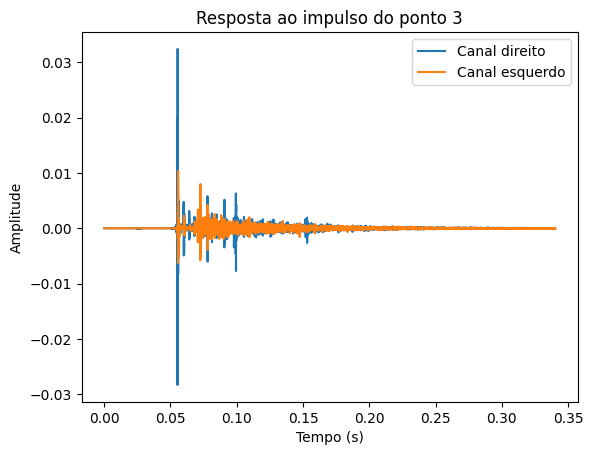

In [4]:
corte=15000
t=np.arange(0, len(resp_imp_3[:corte, 0]) * 1/fs, 1/fs)
plt.plot(t, resp_imp_3[:corte, 0], label='Canal direito')
plt.plot(t, resp_imp_3[:corte, 1], label='Canal esquerdo')
plt.xlabel('Tempo (s)')
plt.ylabel('Amplitude')
plt.title('Resposta ao impulso do ponto 3')
plt.legend()

In [5]:
sf.write("Arquivos/Saídas/BRIR_3.wav",resp_imp_3[:100000],fs)
ipd.Audio(filename='Arquivos/Saídas/BRIR_3.wav',)


# Carregando o som do instrumento

In [6]:
aria_alto, fs = sf.read('Arquivos/Áudios/Aria_Alto.wav')
aria_alto.shape, fs

((2646000,), 44100)

In [7]:
ipd.Audio(filename='Arquivos/Áudios/Aria_Alto.wav')

# Aplicando a convolução para os dois lados

In [8]:
saida_pt1_esq = sp.signal.fftconvolve(aria_alto, resp_imp_3[:, 1])
saida_pt1_dir = sp.signal.fftconvolve(aria_alto, resp_imp_3[:, 0])

# Unindo ambos

In [9]:
saida_pt1 = np.vstack((saida_pt1_esq ,saida_pt1_dir)).transpose()


# Mostrando as saídas

/home/caio/.local/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


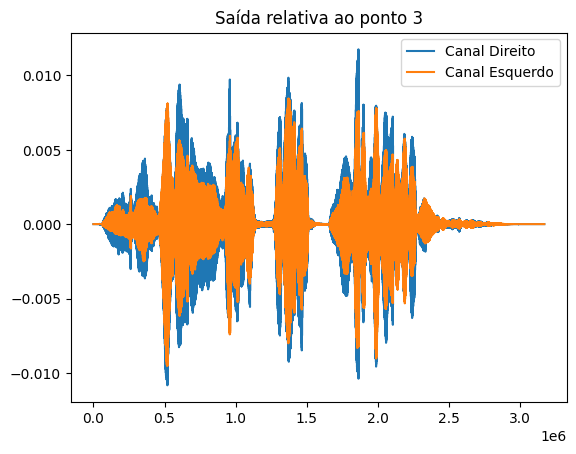

In [10]:
plt.plot(saida_pt1_dir, label="Canal Direito")
plt.plot(saida_pt1_esq, label="Canal Esquerdo")
plt.legend()
plt.title("Saída relativa ao ponto 3")
plt.show()

# Salvando o resultado 

In [11]:
sf.write("Arquivos/Saídas/saida_pt1.wav", saida_pt1 , fs)
ipd.Audio(filename='Arquivos/Saídas/saida_pt1.wav')